In [1]:
import os
import os.path as osp
import sys
sys.path.append("../happy_whale/")

import albumentations as A
import cv2
import numpy as np
import pandas as pd
import plotly.express as px
import torch
from albumentations.pytorch.transforms import ToTensorV2
from torch.nn import functional as F
from torch.utils.data.dataloader import DataLoader
from tqdm.notebook import tnrange, tqdm

from pipeline.dataset import HappyDataset
from pipeline.model import HappyModel
from pipeline.metric import map_per_set


DATA_DIR = "../data/"
TRAIN_CSV = osp.join(DATA_DIR, "train.csv")
TRAIN_IMAGES_DIR = osp.join(DATA_DIR, "train_images_yolov5_9c_v3_512")
TEST_IMAGES_DIR = osp.join(DATA_DIR, "test_images_yolov5_9c_v3_512")

BATCH_SIZE = 16
NUM_WORKERS = 16
DEVICE = "cpu"


def get_model(checkpoint):
    hparams = torch.load(checkpoint, map_location="cpu")["hyper_parameters"]
    model = HappyModel.from_checkpoint(checkpoint).to(DEVICE).eval()
    
    return hparams, model


def get_loaders(train_images_dir, test_images_dir, hparams, second=False):
    transform = A.Compose([
        A.Resize(height=hparams["input_height"], width=hparams["input_width"], always_apply=True),
        A.Normalize(always_apply=True),
        ToTensorV2(always_apply=True),
    ], 
    additional_targets={
        "image_fish": "image",
        "image_full": "image",
    })
    
    _dataset_params = {
        "transform": transform,
        "load_all_fields": True,
        "load_all_images": True,
        "second": second,
    }
    
    train_dataset = HappyDataset.create(train_images_dir, TRAIN_CSV, **_dataset_params)
    test_dataset = HappyDataset.create(test_images_dir, **_dataset_params)
    
    _loader_params = {
        "batch_size": BATCH_SIZE,
        "num_workers": NUM_WORKERS,
        "drop_last": False,
    }

    train_loader = DataLoader(train_dataset, **_loader_params)
    test_loader = DataLoader(test_dataset, **_loader_params)
    
    return train_loader, test_loader


######################
#    Single model
######################
CHECKPOINT = "../happy_whale/pipeline/checkpoints/tf_effb7_ns_m0.4_min2_emb768_viewpoint_yolov5_9c_v3_augv4_2ldp0.4_512x512_4g20x3b60e0.001lr0f/wpoint_yolov5_9c_v3_augv4_2ldp0.4_512x512_4g20x3b60e0.001lr0f/last.ckpt"
EXP = osp.split(CHECKPOINT)[0][36:]

hparams, model = get_model(CHECKPOINT)
train_loader, test_loader = get_loaders(TRAIN_IMAGES_DIR, TEST_IMAGES_DIR, hparams)


######################
#      Ensemble
######################
# CHECKPOINTS = [
#     "../happy_whale/pipeline/checkpoints/tf_effb7_ns_m0.4_yolov5_fin_fish_v1_h20s50v30_b0.2c0.2_2ldp0.4_512x512_4g20x3b40e0.001lr0f/epoch=39-step=6799.ckpt",
#     "../happy_whale/pipeline/checkpoints/tf_effb7_ns_m0.4_yolov5_fin_fish_v1_h20s50v30_b0.2c0.2_2ldp0.4_512x512_4g20x3b40e0.001lr1f/epoch=38-step=6629.ckpt",
#     "../happy_whale/pipeline/checkpoints/tf_effb7_ns_m0.4_yolov5_fin_fish_v1_h20s50v30_b0.2c0.2_2ldp0.4_512x512_4g20x3b40e0.001lr2f/epoch=39-step=6799.ckpt",
#     "../happy_whale/pipeline/checkpoints/tf_effb7_ns_m0.4_yolov5_fin_fish_v1_h20s50v30_b0.2c0.2_2ldp0.4_512x512_4g20x3b40e0.001lr3f/epoch=39-step=6799.ckpt",
#     "../happy_whale/pipeline/checkpoints/tf_effb7_ns_m0.4_yolov5_fin_fish_v1_h20s50v30_b0.2c0.2_2ldp0.4_512x512_4g20x3b40e0.001lr4f/epoch=37-step=6459.ckpt",
# ]

# hparams = torch.load(CHECKPOINTS[0], map_location="cpu")["hyper_parameters"]
# models = [get_model(ckpt)[1] for ckpt in CHECKPOINTS]
# train_loader, test_loader = get_loaders(TRAIN_IMAGES_DIR, TEST_IMAGES_DIR, hparams)


FileNotFoundError: [Errno 2] No such file or directory: '../happy_whale/pipeline/checkpoints/tf_effb7_ns_m0.4_min2_emb768_viewpoint_yolov5_9c_v3_augv4_2ldp0.4_512x512_4g20x3b60e0.001lr0f/wpoint_yolov5_9c_v3_augv4_2ldp0.4_512x512_4g20x3b60e0.001lr0f/last.ckpt'

## Calculate embeddings

In [ ]:
from time import time


def predict(model, train_loader, test_loader, no_pred=False):
    predictions = {
        "klass_probs": [],
        "klass_labels": [],
        "specie_probs": [],
        "specie_labels": [],
        "embeddings": [],
        "individual_ids": [],
        "individual_labels": [],
        "image_ids": [],
        "folds": [],
        "news": [],
        "has_fish": [],
        "has_fin": []
    }
    
    batch_ext = 4
    
    def _predict(batch):
        def _hflip(tensor):
            return torch.flip(tensor, dims=(3,))

        batch_size = len(batch["image"])
        
        image_fin = batch["image"].to(DEVICE)
        image_fish = batch["image_fish"].to(DEVICE)
        image_batch = torch.cat((
            image_fin, 
            image_fish,
            _hflip(image_fin),
            _hflip(image_fish),
        ), dim=0)
        
        with torch.no_grad():
            klass_probs, specie_probs, *_, embeddings = model.predict(image_batch)
            klass_probs = klass_probs.view(batch_ext, batch_size).transpose(0, 1)
            specie_probs = specie_probs.view(batch_ext, batch_size, specie_probs.shape[-1]).transpose(0, 1)
            embeddings = embeddings.view(batch_ext, batch_size, embeddings.shape[-1]).transpose(0, 1)
            
        return klass_probs.cpu(), specie_probs.cpu(), embeddings.cpu()
        

    # Train
    for bi, batch in enumerate(tqdm(train_loader, desc="Calculating train embeddings", unit="batch")):
        predictions["individual_ids"].extend(batch["individual_id"])
        predictions["individual_labels"].extend(batch["individual_label"])
        predictions["klass_labels"].extend(batch["klass_label"])
        predictions["specie_labels"].extend(batch["specie_label"])
        predictions["image_ids"].extend([osp.basename(image_file) for image_file in batch["image_file"]])
        predictions["folds"].extend(batch["fold"])
        predictions["news"].extend(batch["new"])
        for i in range(len(batch["image_file"])):
            predictions["has_fish"].append(batch["image_file_fish"][i] != "")
            predictions["has_fin"].append(batch["image_file_fin"][i] != "")
        if no_pred:
            continue
        
        klass_probs, specie_probs, embeddings = _predict(batch)
        predictions["klass_probs"].extend(klass_probs)
        predictions["specie_probs"].extend(specie_probs)
        predictions["embeddings"].extend(embeddings)
            
    # Test
    for batch in tqdm(test_loader, desc="Calculating test embeddings", unit="batch"):
        predictions["individual_ids"].extend(["new_individual"] * len(batch["individual_id"]))
        predictions["individual_labels"].extend([-1] * len(batch["individual_label"]))
        predictions["klass_labels"].extend([-1] * len(batch["klass_label"]))
        predictions["specie_labels"].extend([-1] * len(batch["specie_label"]))
        predictions["image_ids"].extend([osp.basename(image_file) for image_file in batch["image_file"]])
        predictions["folds"].extend(batch["fold"])
        predictions["news"].extend(batch["new"])
        for i in range(len(batch["image_file"])):
            predictions["has_fish"].append(batch["image_file_fish"][i] != "")
            predictions["has_fin"].append(batch["image_file_fin"][i] != "")
        if no_pred:
            continue

        klass_probs, specie_probs, embeddings = _predict(batch)    
        predictions["klass_probs"].extend(klass_probs)
        predictions["specie_probs"].extend(specie_probs)
        predictions["embeddings"].extend(embeddings)

    if not no_pred:
        predictions["embeddings"] = torch.stack(predictions["embeddings"])
        predictions["klass_probs"] = torch.stack(predictions["klass_probs"])
        predictions["specie_probs"] = torch.stack(predictions["specie_probs"])
    
    predictions["individual_ids"] = np.asarray(predictions["individual_ids"])
    predictions["individual_labels"] = np.asarray(predictions["individual_labels"])
    predictions["image_ids"] = np.asarray(predictions["image_ids"])
    predictions["folds"] = np.asarray(predictions["folds"])
    predictions["news"] = np.asarray(predictions["news"])

    predictions["klass_labels"] = np.asarray(predictions["klass_labels"])
    predictions["specie_labels"] = np.asarray(predictions["specie_labels"])
    
    return predictions

In [2]:
# predictions = {
#     "image_ids": np.load("../predictions/image_ids.npy"),
#     "news": np.load("../predictions/news.npy"),
#     "folds": np.load("../predictions/folds.npy"),
#     "klass_labels": np.load("../predictions/klass_labels.npy"),
#     "specie_labels": np.load("../predictions/specie_labels.npy"),
#     "individual_ids": np.load("../predictions/individual_ids.npy"),
#     "individual_labels": np.load("../predictions/individual_labels.npy"),
# }

In [ ]:
######################
#    Single model
######################
predictions = predict(model, train_loader, test_loader)

assert (predictions["image_ids"] == np.load("../predictions/image_ids.npy")).all()

Calculating train embeddings:   0%|          | 0/3190 [00:00<?, ?batch/s]

In [7]:
torch.save(predictions["embeddings"], f"../predictions/{EXP}_embeddings.pt")
torch.save(predictions["klass_probs"], f"../predictions/{EXP}_klass_probs.pt")
torch.save(predictions["specie_probs"], f"../predictions/{EXP}_specie_probs.pt")

# EXP = "tf_effb7_ns_m0.4_yolov5_9c_v3_augv3_2ldp0.4_512x512_4g20x3b60e0.001lr"
# EXP = "tf_effb7_ns_m0.4_viewpoint_yolov5_9c_v5_augv4_2ldp0.4_512x512_4g20x3b60e0.001lr0f"
# EXP = "tf_effb6_ns_m0.4_viewpoint_yolov5_9c_v5_augv4_2ldp0.4_512x512_4g26x2b60e0.001lr0f"
# predictions["embeddings"] = torch.load(f"../predictions/{EXP}_embeddings.pt")
# predictions["klass_probs"] = torch.load(f"../predictions/{EXP}_klass_probs.pt")
# predictions["specie_probs"] = torch.load(f"../predictions/{EXP}_specie_probs.pt")

In [7]:
# EXP = "tf_effb7_ns_m0.4_viewpoint_yolov5_9c_v3_augv4_2ldp0.4_512x512_4g20x3b60e0.001lr"

# emb0 = torch.load(f"../predictions/{EXP}0f_embeddings.pt")
# sp0 = torch.load(f"../predictions/{EXP}0f_specie_probs.pt")
# kl0 = torch.load(f"../predictions/{EXP}0f_klass_probs.pt")

# emb1 = torch.load(f"../predictions/{EXP}1f_embeddings.pt")
# sp1 = torch.load(f"../predictions/{EXP}1f_specie_probs.pt")
# kl1 = torch.load(f"../predictions/{EXP}1f_klass_probs.pt")

# emb2 = torch.load(f"../predictions/{EXP}2f_embeddings.pt")
# sp2 = torch.load(f"../predictions/{EXP}2f_specie_probs.pt")
# kl2 = torch.load(f"../predictions/{EXP}2f_klass_probs.pt")

# emb3 = torch.load(f"../predictions/{EXP}3f_embeddings.pt")
# sp3 = torch.load(f"../predictions/{EXP}3f_specie_probs.pt")
# kl3 = torch.load(f"../predictions/{EXP}3f_klass_probs.pt")

# emb4 = torch.load(f"../predictions/{EXP}4f_embeddings.pt")
# sp4 = torch.load(f"../predictions/{EXP}4f_specie_probs.pt")
# kl4 = torch.load(f"../predictions/{EXP}4f_klass_probs.pt")

# emb = torch.stack((emb0, emb1, emb2, emb3, emb4))
# sp = torch.stack((sp0, sp1, sp2, sp3, sp4))
# kl = torch.stack((kl0, kl1, kl2, kl3, kl4))

In [8]:
# EXP = "tf_effb6_ns_m0.4_viewpoint_yolov5_9c_v3_augv4_2ldp0.4_512x512_4g26x2b60e0.001lr"
# torch.save(emb, f"../final_predictions/{EXP}_embeddings.pt")
# torch.save(kl, f"../final_predictions/{EXP}_klass_probs.pt")
# torch.save(sp, f"../final_predictions/{EXP}_specie_probs.pt")

In [9]:
predictions["embeddings"] = emb
predictions["klass_probs"] = kl
predictions["specie_probs"] = sp

In [251]:
EXP = "tf_effb7_ns_m0.4_viewpoint_yolov5_9c_v5_augv4_2ldp0.4_512x512_4g20x3b60e0.001lr"
emb_v5b7 = torch.load(f"../final_predictions/{EXP}_embeddings.pt")
sp_v5b7 = torch.load(f"../final_predictions/{EXP}_specie_probs.pt")
kl_v5b7 = torch.load(f"../final_predictions/{EXP}_klass_probs.pt")

EXP = "tf_effb7_ns_m0.4_yolov5_9c_v3_augv3_2ldp0.4_512x512_4g20x3b60e0.001lr"
emb_v31b7 = torch.load(f"../final_predictions/{EXP}_embeddings.pt")
sp_v31b7 = torch.load(f"../final_predictions/{EXP}_specie_probs.pt")
kl_v31b7 = torch.load(f"../final_predictions/{EXP}_klass_probs.pt")

EXP = "tf_effb6_ns_m0.4_viewpoint_yolov5_9c_v5_augv4_2ldp0.4_512x512_4g26x2b60e0.001lr"
emb_v5b6 = torch.load(f"../final_predictions/{EXP}_embeddings.pt")
sp_v5b6 = torch.load(f"../final_predictions/{EXP}_specie_probs.pt")
kl_v5b6 = torch.load(f"../final_predictions/{EXP}_klass_probs.pt")

# EXP = "tf_effb6_ns_m0.4_viewpoint_yolov5_9c_v3_augv4_2ldp0.4_512x512_4g26x2b60e0.001lr"
# emb_v3b6 = torch.load(f"../final_predictions/{EXP}_embeddings.pt")
# sp_v3b6 = torch.load(f"../final_predictions/{EXP}_specie_probs.pt")
# kl_v3b6 = torch.load(f"../final_predictions/{EXP}_klass_probs.pt")

embs = [emb_v5b7, emb_v31b7, emb_v5b6]
sps = [sp_v5b7, sp_v31b7, sp_v5b6]
kls = [kl_v5b7, kl_v31b7, kl_v5b6]

# predictions["embeddings"] = F.normalize(torch.stack(embs), dim=4).mean(dim=0)[0, :, 0]
predictions["embeddings"] = torch.stack(embs)[0, 0, :, 0]
# predictions["embeddings"] = F.normalize(torch.stack(embs)[0, 0, :, [0, 1]], dim=-1).mean(dim=1)
predictions["specie_probs"] = (sp_v5b7 + sp_v31b7 + sp_v5b6) / 3
predictions["klass_probs"] = (kl_v5b7 + kl_v31b7 + kl_v5b6) / 3

In [35]:
x = F.normalize(torch.stack(embs), dim=4).mean(dim=3)
x = x.transpose(0, 2).reshape((x.size(2), -1))

In [36]:
x.shape

torch.Size([78989, 10240])

In [139]:
klass_probs = torch.load(
    "../final_predictions/tf_effb7_ns_m0.4_yolov5_9c_v3_augv3_2ldp0.4_512x512_4g20x3b60e0.001lr_klass_probs.pt")
# klass_probs = predictions["klass_probs"]
klass_preds = (klass_probs.mean(dim=(0, 2)) > 0.5).int()
klass_labels = predictions["klass_labels"]
klass_labels[klass_labels == -1] = klass_preds[klass_labels == -1]

In [140]:
specie_probs = torch.load(
    "../final_predictions/tf_effb7_ns_m0.4_yolov5_9c_v3_augv3_2ldp0.4_512x512_4g20x3b60e0.001lr_specie_probs.pt")
# specie_probs = predictions["specie_probs"]
specie_probs, specie_preds = specie_probs.mean(dim=(0, 2)).max(dim=1)
specie_labels = predictions["specie_labels"]
specie_labels[specie_labels == -1] = specie_preds[specie_labels == -1]
specie_probs[specie_labels != -1] = 1.0

In [ ]:
# predictions["embeddings"] = torch.load(f"../predictions/{EXP}_embeddings.pt")

In [161]:
label2specie

{15: 'melon_headed_whale',
 12: 'humpback_whale',
 8: 'false_killer_whale',
 2: 'bottlenose_dolphin',
 0: 'beluga_whale',
 16: 'minke_whale',
 9: 'fin_whale',
 1: 'blue_whale',
 11: 'gray_whale',
 22: 'southern_right_whale',
 5: 'common_dolphin',
 13: 'killer_whale',
 21: 'short_finned_pilot_whale',
 7: 'dusky_dolphin',
 14: 'long_finned_pilot_whale',
 20: 'sei_whale',
 23: 'spinner_dolphin',
 6: 'cuviers_beaked_whale',
 24: 'spotted_dolphin',
 3: 'brydes_whale',
 4: 'commersons_dolphin',
 25: 'white_sided_dolphin',
 19: 'rough_toothed_dolphin',
 17: 'pantropic_spotted_dolphin',
 18: 'pygmy_killer_whale',
 10: 'frasiers_dolphin'}

In [6]:
import plotly.express as px

px.histogram(x=specie_labels[predictions["folds"] != -1]).show()

In [8]:
px.histogram(x=specie_labels[predictions["folds"] == -1]).show()

In [16]:
df = pd.read_csv("../data/train.csv")
px.histogram(df, x="individual_id").show()

In [40]:
from collections import Counter

counts = Counter(df["individual_id"].value_counts())
total = sum(counts.values())
for k, v in counts.items():
    if k < 20:
        print(f"{k}: {v / total:.3f}")

19: 0.001
18: 0.002
17: 0.002
16: 0.001
15: 0.003
14: 0.003
13: 0.002
12: 0.005
11: 0.006
10: 0.003
9: 0.007
8: 0.010
7: 0.007
6: 0.009
5: 0.024
4: 0.048
3: 0.050
2: 0.198
1: 0.594


In [171]:
sdf = pd.read_csv("../submissions/b7v5_b7v3_b6v5_f01234_859_th0.41_no_dup_both_hflip.csv")
sdf["individual_id"] = sdf["predictions"].apply(lambda x: x.split()[0])
counts = Counter(sdf["individual_id"].value_counts())
total = sum(counts.values())
for k, v in counts.items():
    if k < 20:
        print(f"{k}: {v / total:.3f}")

19: 0.005
18: 0.004
17: 0.003
16: 0.003
15: 0.003
14: 0.005
13: 0.005
12: 0.003
11: 0.005
10: 0.007
9: 0.007
8: 0.013
7: 0.012
6: 0.022
5: 0.026
4: 0.051
3: 0.081
2: 0.197
1: 0.523


In [185]:
uniq_iids = sdf["individual_id"].value_counts()[(sdf["individual_id"].value_counts() == 1)].index
Counter(df[df.individual_id.isin(uniq_iids)].individual_id.value_counts())

Counter({18: 1,
         12: 1,
         11: 2,
         10: 1,
         9: 2,
         8: 6,
         7: 4,
         6: 14,
         5: 43,
         4: 99,
         3: 140,
         2: 1160,
         1: 2448})

In [35]:
5067 / len(sdf)

0.18124910573758765

In [42]:
for fold in range(5):
    fold_indices = predictions["folds"] == fold
    print(predictions["news"][fold_indices].sum() / fold_indices.sum())

0.18124816302537475
0.1845792103458411
0.18310963064563535
0.18048206937095826
0.1776406035665295


In [43]:
sdf = pd.read_csv("../submissions/tf_effb7_m0.4_min2_viewpoint_yolov5_9c_v3_augv4_2ldp0.4_512x512_4g20x3b60e0.001lr0f_f0_809_th0.25_no_dup_both_hflip.csv")
sdf["individual_id"] = sdf["predictions"].apply(lambda x: x.split()[0])
counts = Counter(sdf["individual_id"].value_counts())
total = sum(counts.values())
for k, v in counts.items():
    if k < 20:
        print(f"{k}: {v / total:.3f}")

19: 0.005
18: 0.004
17: 0.005
16: 0.005
15: 0.005
14: 0.003
13: 0.006
12: 0.005
11: 0.004
10: 0.008
9: 0.007
8: 0.012
7: 0.010
6: 0.021
5: 0.025
4: 0.038
3: 0.082
2: 0.193
1: 0.538


In [44]:
counts

Counter({10603: 1,
         46: 1,
         41: 1,
         31: 1,
         28: 1,
         27: 2,
         26: 3,
         25: 1,
         24: 2,
         23: 7,
         22: 10,
         21: 25,
         20: 79,
         19: 30,
         18: 21,
         17: 28,
         16: 30,
         15: 29,
         14: 20,
         13: 36,
         12: 28,
         11: 23,
         10: 45,
         9: 38,
         8: 68,
         7: 56,
         6: 123,
         5: 146,
         4: 222,
         3: 475,
         2: 1114,
         1: 3103})

In [45]:
10603 / len(sdf)

0.37927457433109174

## Submit helpers

In [74]:
def blend_embeddings(embeddings, dist_thresh=0.2):
    topk_distances, topk_predictions = topk(embeddings, embeddings, k=1000)
    
    blended_embeddings = []
    for i, emb in enumerate(tqdm(embeddings, desc="Blending embeddings")):
        dists_i, preds_i = topk_distances[i], topk_predictions[i]

        keep = (dists_i < dist_thresh)
        dists_i, preds_i = dists_i[keep], preds_i[keep]    
        assert len(dists_i) >= 1

        if len(dists_i) == 1:
            blended_embeddings.append(emb)
            continue

        similarities_i = 1. - dists_i
        blended_embeddings.append((embeddings[preds_i] * similarities_i[:, None]).sum(dim=0))

    blended_embeddings = F.normalize(torch.stack(blended_embeddings), dim=-1)
    return blended_embeddings


In [114]:
from collections import defaultdict


def topk(train_embeddings, test_embeddings, k=100):
    _distance = 1 - torch.mm(F.normalize(test_embeddings), F.normalize(train_embeddings).T)
    topk_distances, topk_predictions = torch.topk(_distance, k=k, largest=False, dim=1)
    return topk_distances, topk_predictions


def average_by_individual(train_indices, train_embeddings, train_individuals):
    embeddings_by_individuals = defaultdict(list)
    indices_by_individuals = defaultdict(list)
    for i, emb, ind in zip(train_indices, train_embeddings, train_individuals):
        embeddings_by_individuals[ind].append(emb)
        indices_by_individuals[ind].append(i)

    train_individuals, train_embeddings = [], []
    for ind, ind_embs in embeddings_by_individuals.items():
        train_individuals.append(ind)
        train_embeddings.append(torch.stack(ind_embs).mean(axis=0))
    
    train_individuals = np.asarray(train_individuals)
    train_embeddings = torch.stack(train_embeddings)
    train_indices = np.asarray([indices_by_individuals[ind][0] for ind in train_individuals])
    
    return train_indices, train_embeddings, train_individuals


def build_submit(
    train_indices, 
    test_indices, 
    k=5, 
    new_threshold=0.5, 
    val=False, 
    filter_duplicates=True, 
    filter_by_klass=True, 
    filter_by_specie=True, 
    min_specie_prob=0.7, 
    fold=None, 
    average_by_individ=False
):
    # Train and test should not overlap!
    assert len(set(train_indices) & set(test_indices)) == 0
    
    if fold is None:
        train_embeddings = predictions["embeddings"][train_indices]
        test_embeddings = predictions["embeddings"][test_indices]
    else:
        train_embeddings = predictions["embeddings"][fold][train_indices]
        test_embeddings = predictions["embeddings"][fold][test_indices]
        
    train_individuals = predictions["individual_ids"][train_indices]
    test_individuals = predictions["individual_ids"][test_indices]
    
    if average_by_individ:
        train_indices, train_embeddings, train_individuals = \
            average_by_individual(train_indices, train_embeddings, train_individuals)
    
    topk_distances, topk_predictions = topk(train_embeddings, test_embeddings, k=min(1000, len(train_embeddings)))
    
    submit = []
    for index, pred, dist in zip(test_indices, topk_predictions, topk_distances):
        # Filter by klass
        if filter_by_klass:
            keep = np.where(klass_labels[train_indices][pred] == klass_labels[index])[0]
            pred, dist = pred[keep], dist[keep]
            
        if filter_by_specie and specie_probs[index] >= min_specie_prob and len(pred) > 0:
            keep = np.where(specie_labels[train_indices][pred] == specie_labels[index])[0]
            pred, dist = pred[keep], dist[keep]
        
        pred_ids = train_individuals[pred].tolist()

        # Remove duplicates
        if filter_duplicates and len(pred_ids) > 0:
            seen = set()
            _pred_ids, _dist = [], []
            for pid, di in zip(pred_ids, dist):
                if pid in seen:
                    continue
                seen.add(pid)
                _pred_ids.append(pid)
                _dist.append(di)
                if len(_pred_ids) >= k:  # We need only top k ids
                    break
            pred_ids, dist = _pred_ids, _dist
            
        pred_ids, dist = pred_ids[:k], dist[:k]
        
        # Add new_individual
        if len(dist) == 0:
            pred_ids = ["new_individual"]
        elif dist[-1] > new_threshold:
            new_i = min(i for i, d in enumerate(dist) if d > new_threshold)
            pred_ids = pred_ids[:new_i] + ["new_individual"] + pred_ids[new_i:-1]

        row = {
            "image": predictions["image_ids"][index],
            "predictions": " ".join(pred_ids),
        }        
        if val:
            row["new"] = predictions["news"][index]
            row["index"] = index
            
        submit.append(row)
        
    return pd.DataFrame(submit)


def map_submit(test_indices, submit, k=5):
    test_predictions = []
    for _, r in submit.iterrows():
        p = r["predictions"]
        if r.new:
            p = p.replace("new_individual", predictions["individual_ids"][r["index"]])
        test_predictions.append(p.split())
        
    test_individuals = predictions["individual_ids"][test_indices]
    return map_per_set(test_individuals, test_predictions, topk=k)

## Threshold

In [47]:
def choose_threshold(train_indices, test_indices, t_min=0.37, t_max=0.45, t_step=0.01, plot=False, **kw):
    thresholds = np.arange(t_min, t_max, t_step)
    
    maps5 = []
    best_thresh, best_map = 0, 0
    for threshold in tqdm(thresholds):
        submit = build_submit(train_indices, test_indices, new_threshold=threshold, val=True, **kw)
        map5 = map_submit(test_indices, submit)
        if map5 > best_map:
            best_thresh, best_map = threshold, map5
        maps5.append(map5)
        
    if plot:
        px.scatter(x=thresholds, y=maps5).show()
        
    return best_thresh, best_map, maps5


def choose_threshold_cv(*args, **kwargs):
    all_embeddings = predictions["embeddings"]
    
    best_thresholds, best_maps = [], []
    try:
        for fold in range(5):
            predictions["embeddings"] = F.normalize(all_embeddings[fold], dim=2).mean(dim=1)
            train_indices = np.where((predictions["folds"] != fold) & (predictions["folds"] != -1))[0]
            test_indices = np.where(predictions["folds"] == fold)[0]
            best_thresh, best_map, maps5 = choose_threshold(train_indices, test_indices, *args, **kwargs)
            print(best_thresh, best_map)
            best_thresholds.append(best_thresh)
            best_maps.append(best_map)

    except:
        raise
    finally:
        predictions["embeddings"] = all_embeddings
        
    return best_thresholds, best_maps

In [188]:
fold = 0

train_indices = np.where((predictions["folds"] != fold) & (predictions["folds"] != -1))[0]
test_indices = np.where(predictions["folds"] == fold & (predictions["news"] != 1))[0]

embeddings = predictions["embeddings"]
train_embeddings = embeddings[train_indices]
test_embeddings = embeddings[test_indices]

topk_distances, topk_predictions = topk(train_embeddings, train_embeddings, k=1)

In [189]:
px.histogram(x=topk_distances.numpy()[:, 0])

In [190]:
test_indices = np.where(predictions["folds"] == fold & (predictions["news"] != 1))[0]

embeddings = predictions["embeddings"]
train_embeddings = embeddings[train_indices]
test_embeddings = embeddings[test_indices]

topk_distances, topk_predictions = topk(train_embeddings, test_embeddings, k=1)
px.histogram(x=topk_distances.numpy()[:, 0])

In [191]:
test_indices = np.where((predictions["folds"] == fold) & (predictions["news"] != 1))[0]
test_embeddings = embeddings[test_indices]

topk_distances, topk_predictions = topk(train_embeddings, test_embeddings, k=1)
px.histogram(x=topk_distances.numpy()[:, 0])

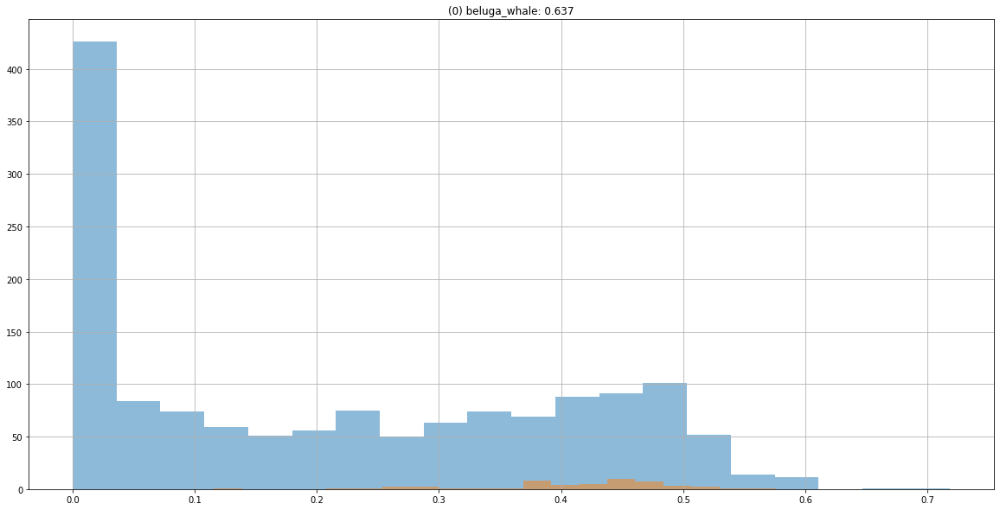

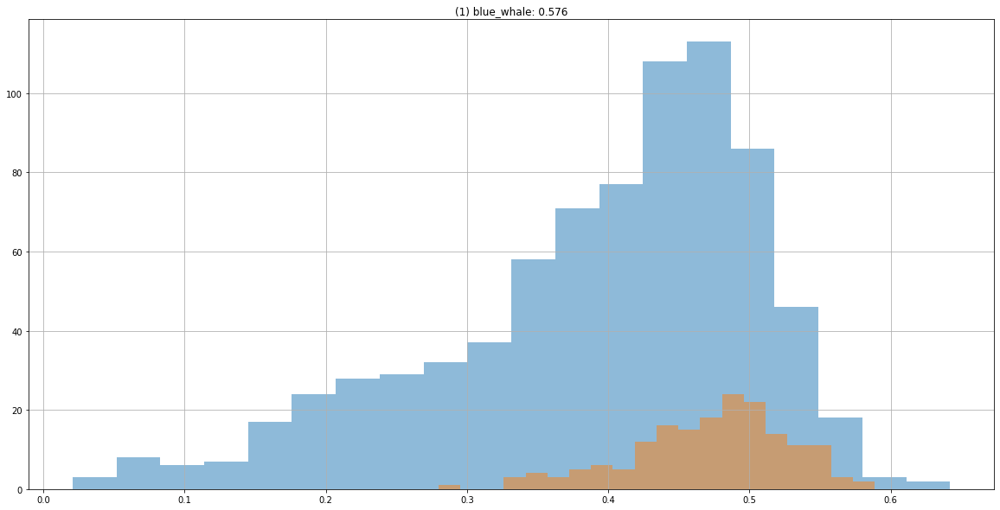

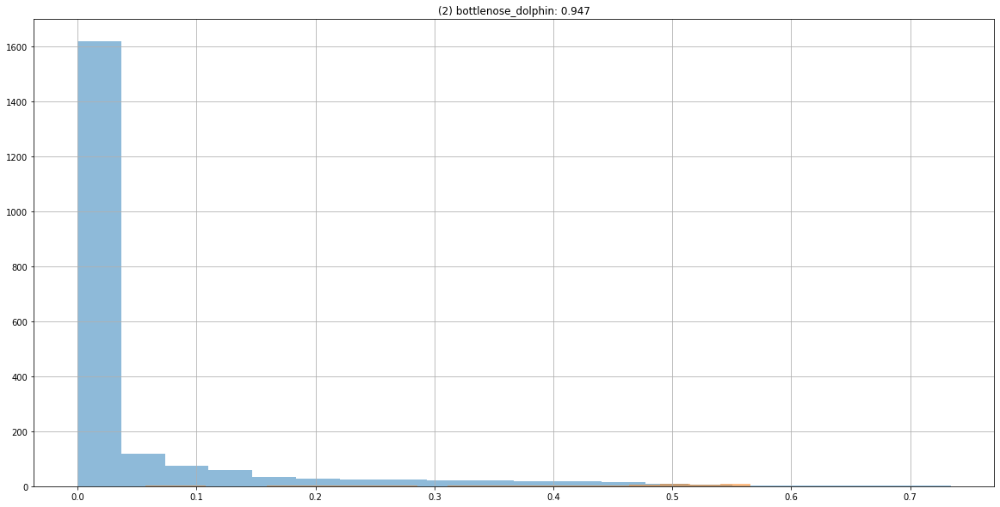

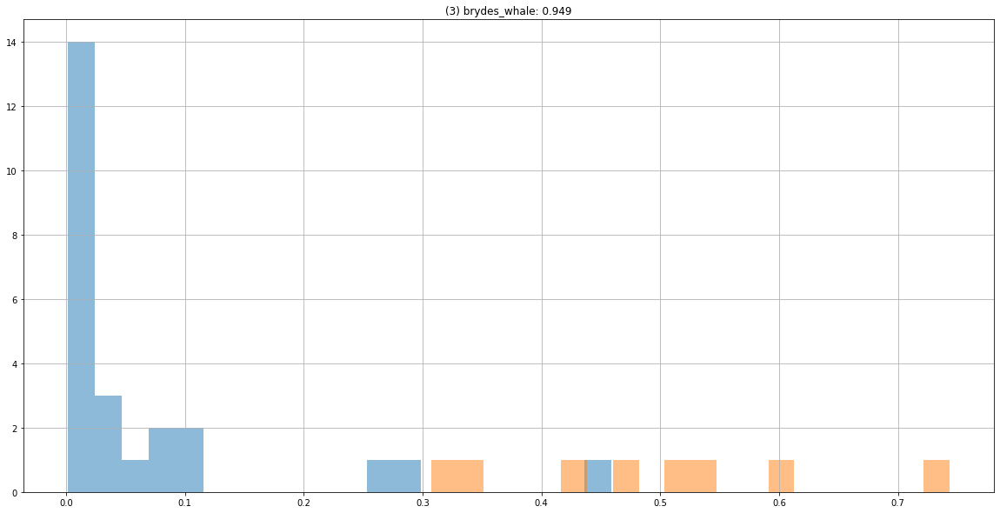

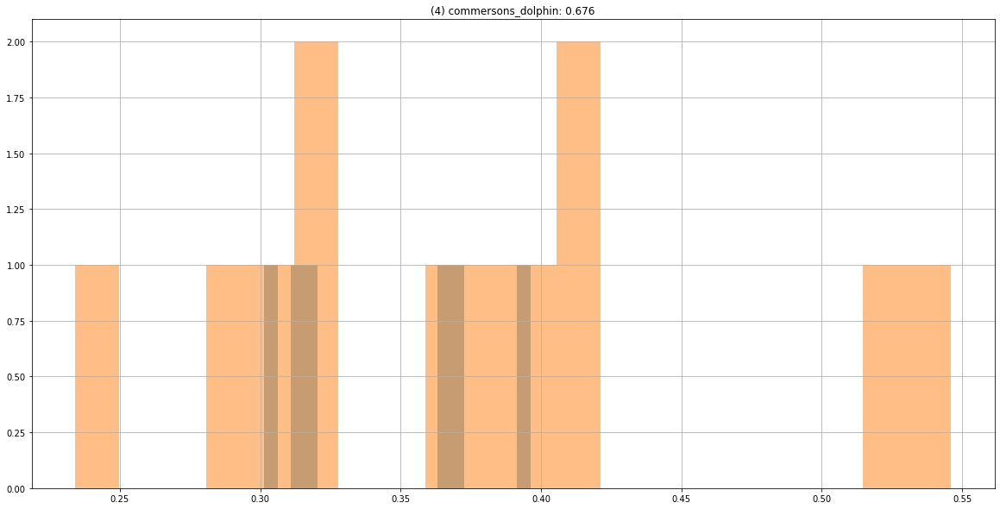

...

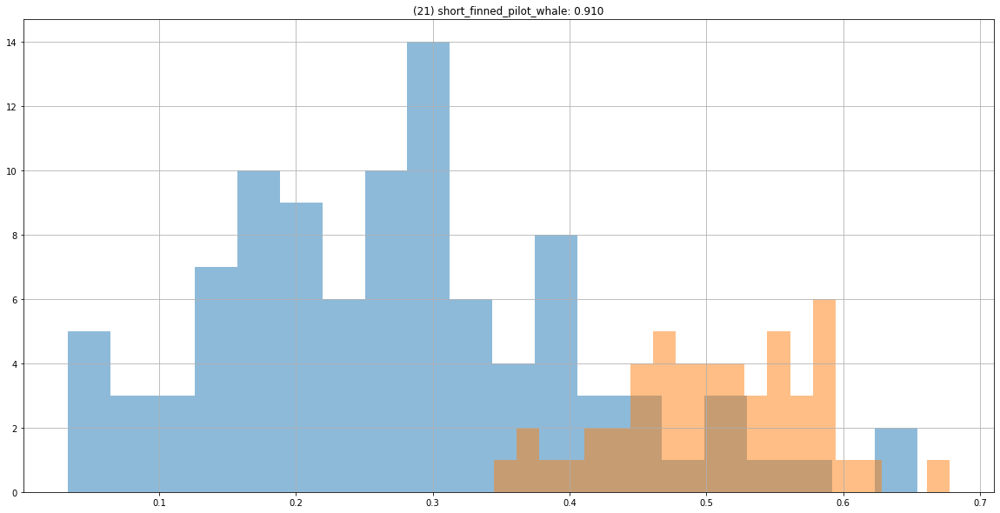

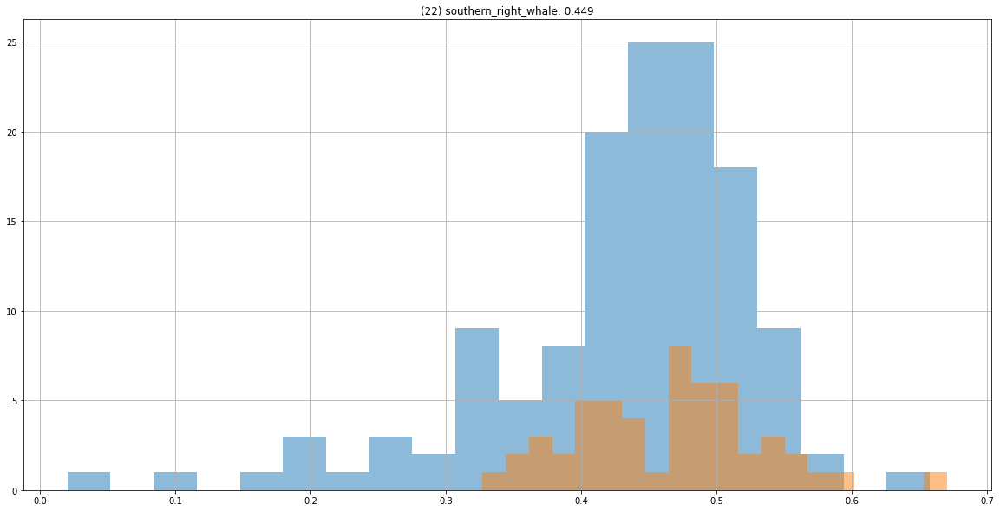

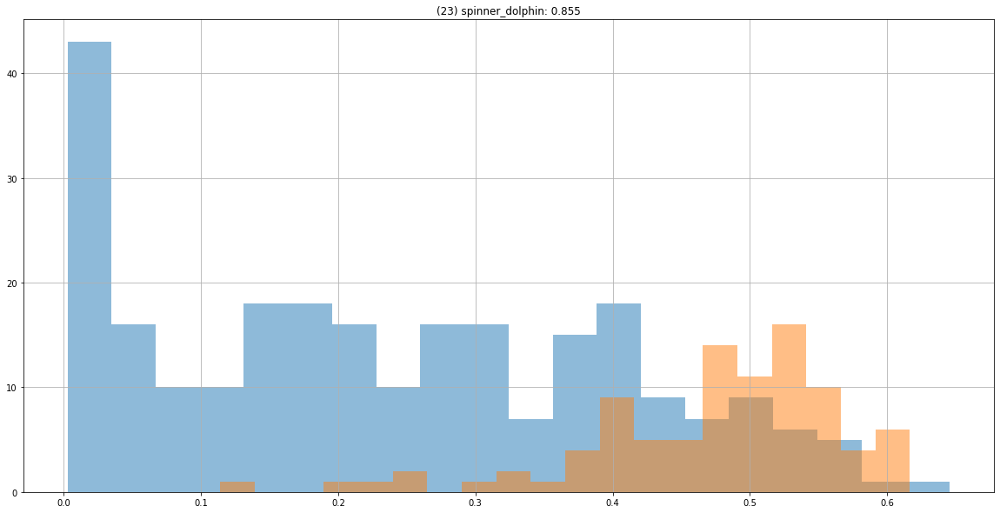

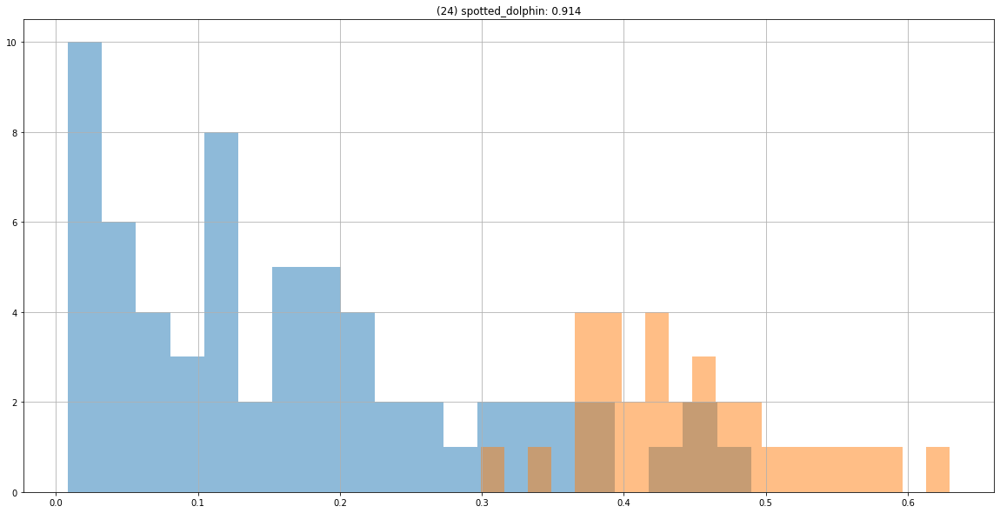

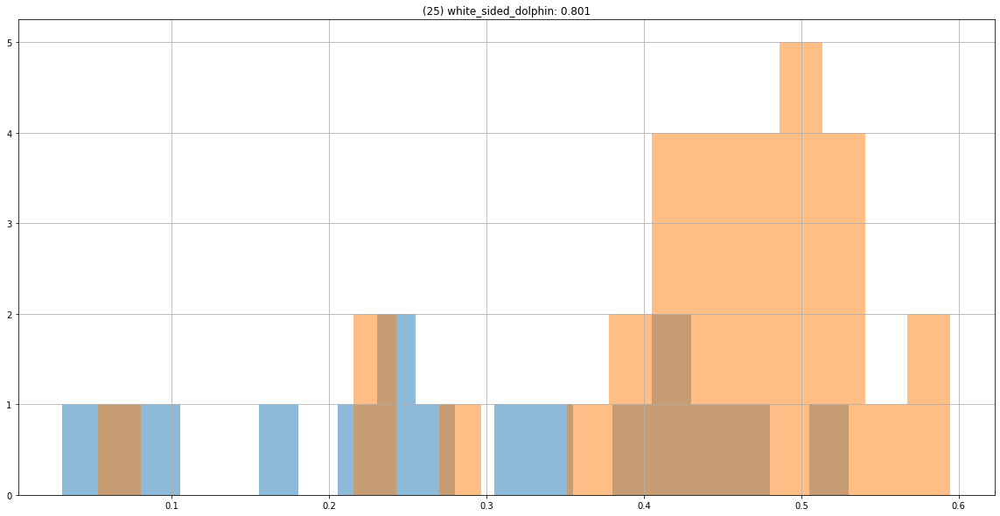

In [192]:
from matplotlib import pyplot as plt


for specie in range(26):
    train_indices = np.where((predictions["folds"] != fold) & (predictions["folds"] != -1) & 
                             (predictions["specie_labels"] == specie))[0]
    test_indices = np.where((predictions["folds"] == fold) & (predictions["specie_labels"] == specie))[0]
    submit = build_submit(train_indices, test_indices, new_threshold=0.4, val=True)
    map5 = map_submit(test_indices, submit)
    
    train_indices = np.where((predictions["folds"] != fold) & (predictions["folds"] != -1) & 
                             (predictions["specie_labels"] == specie))[0]
    test_indices = np.where((predictions["folds"] == fold) & (predictions["news"] != 1) & 
                             (predictions["specie_labels"] == specie))[0]

    embeddings = predictions["embeddings"]
    train_embeddings = embeddings[train_indices]
    test_embeddings = embeddings[test_indices]

    topk_distances, topk_predictions = topk(train_embeddings, test_embeddings, k=1)
    plt.figure(figsize=(20, 10))
    plt.hist(topk_distances.numpy()[:, 0], alpha=0.5, bins=20)

    test_indices = np.where((predictions["folds"] == fold) & (predictions["news"] == 1) & 
                             (predictions["specie_labels"] == specie))[0]
    test_embeddings = embeddings[test_indices]

    topk_distances, topk_predictions = topk(train_embeddings, test_embeddings, k=1)
    plt.hist(topk_distances.numpy()[:, 0], alpha=0.5, bins=20)

    plt.grid()
    plt.title(f"({specie}) {label2specie[specie]}: {map5:.3f}")
    plt.show()

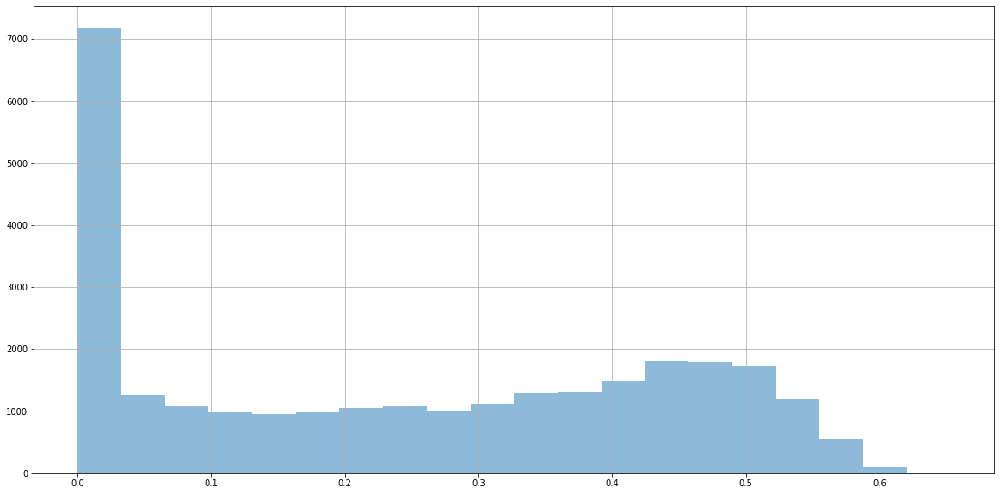

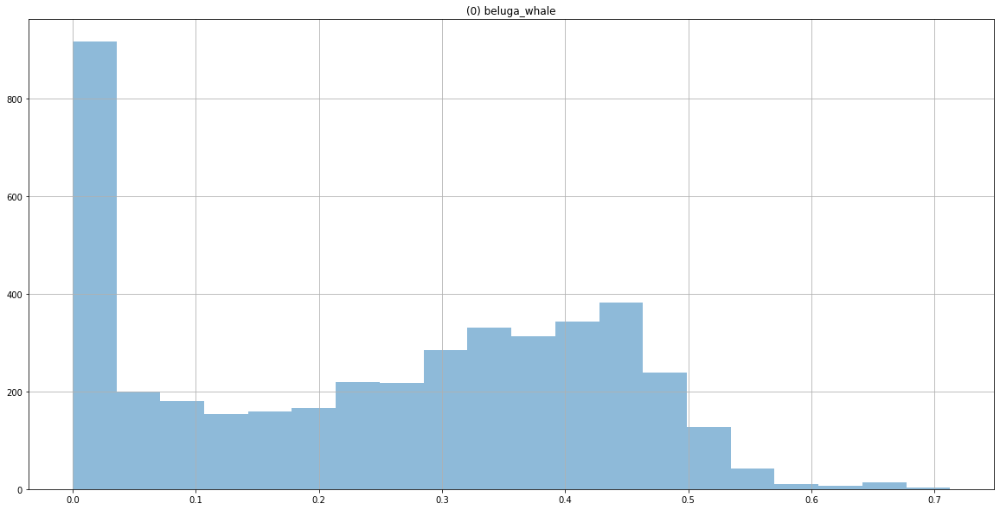

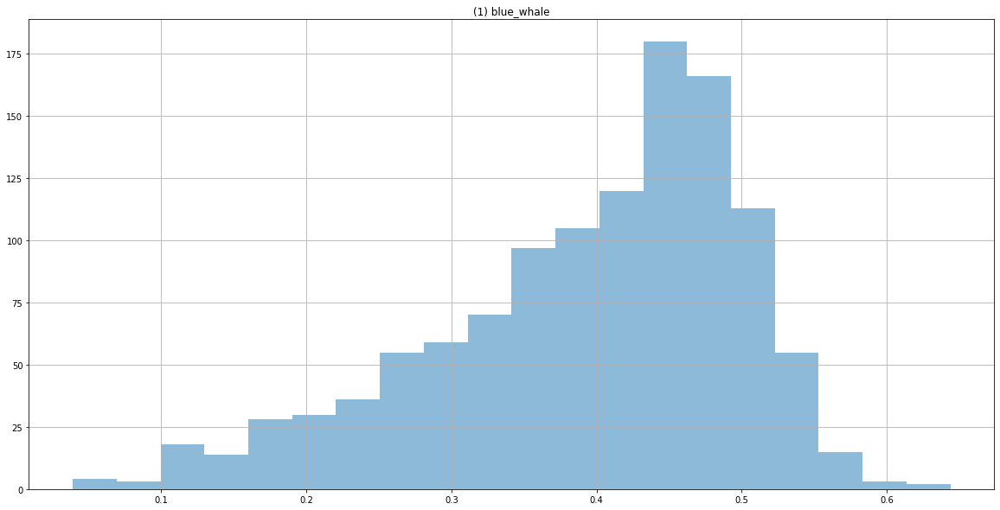

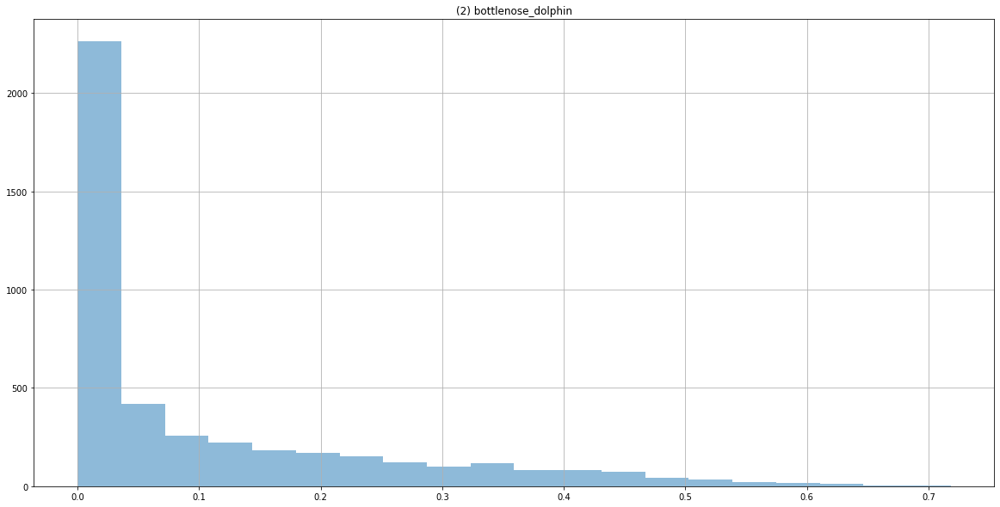

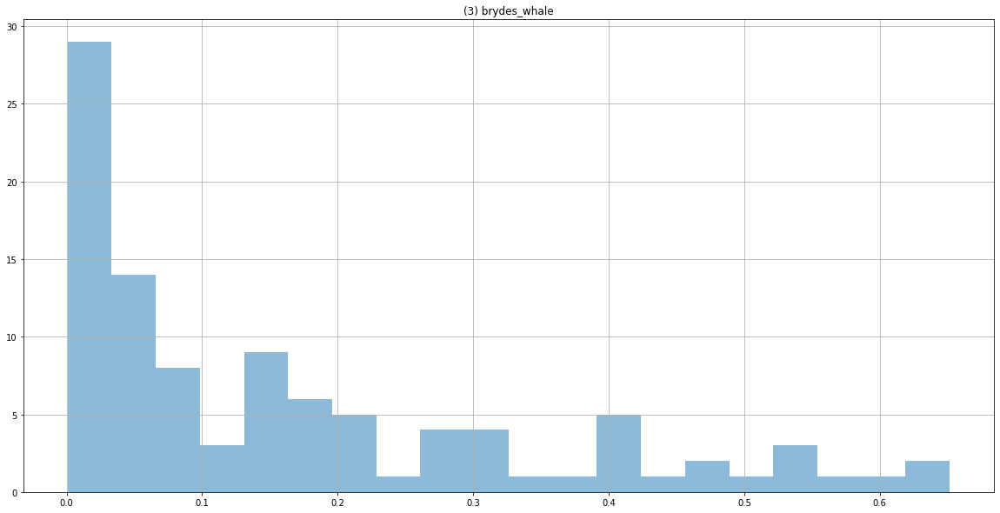

...

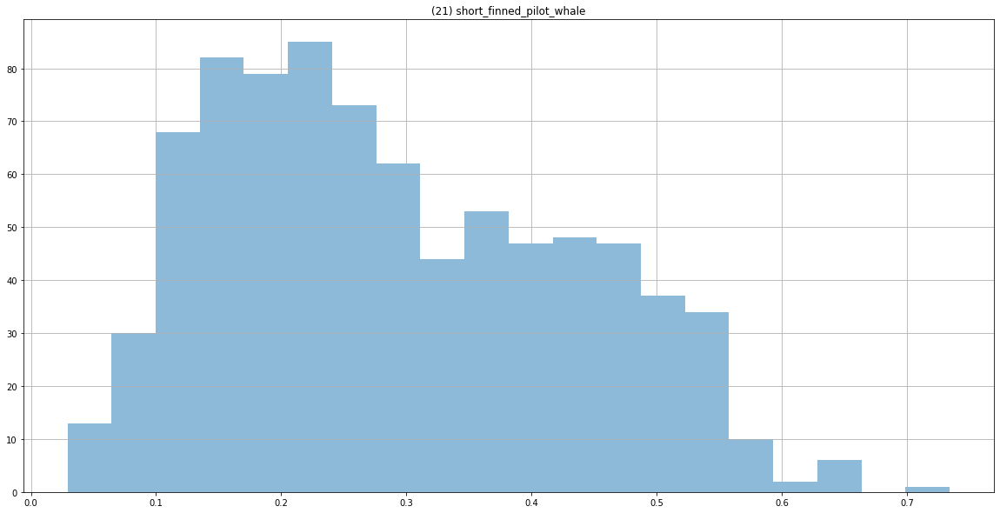

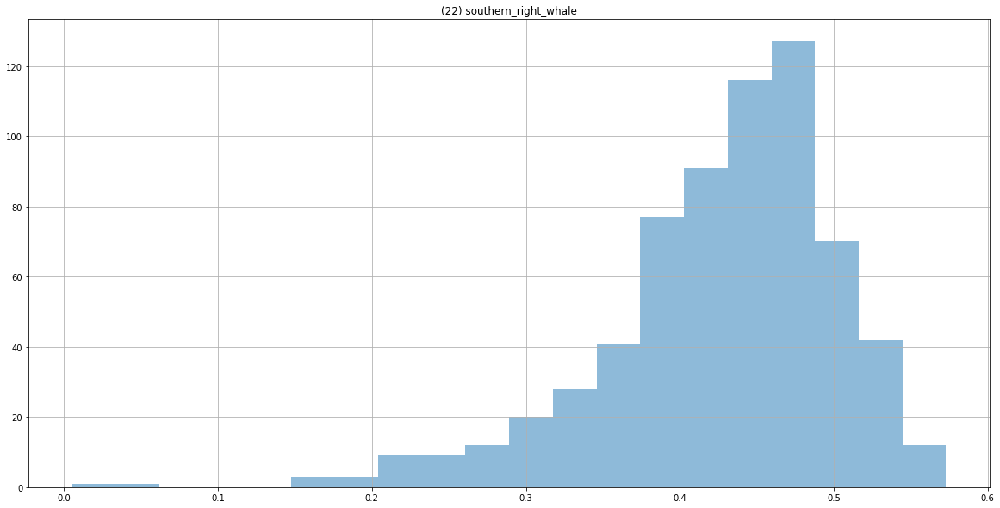

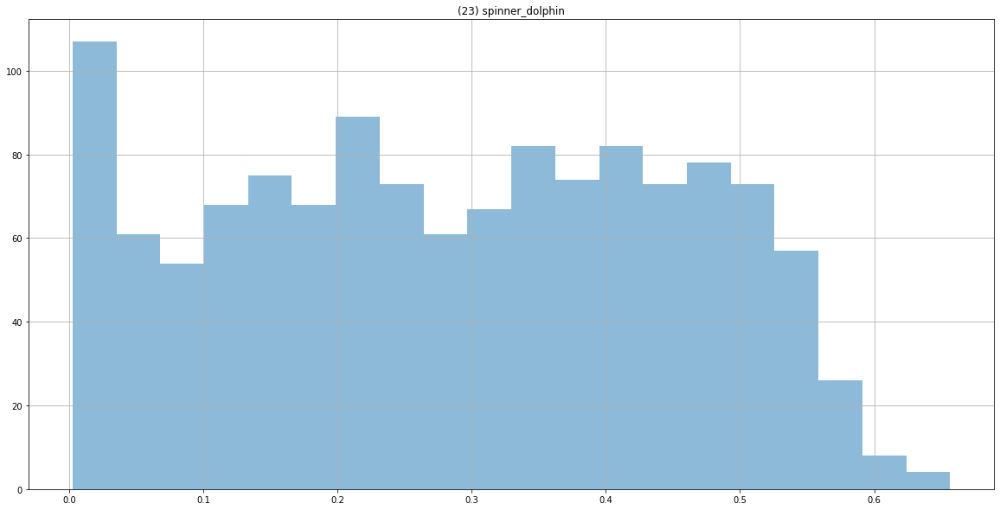

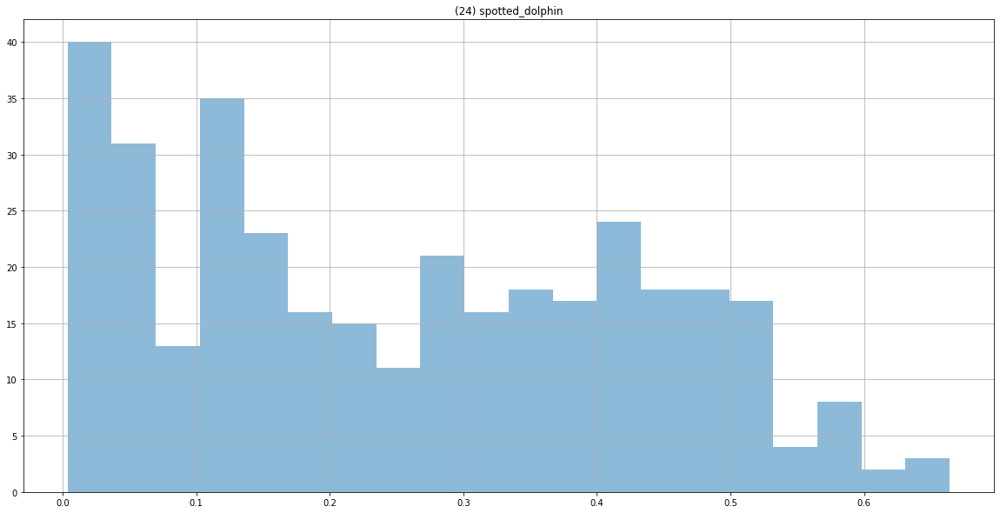

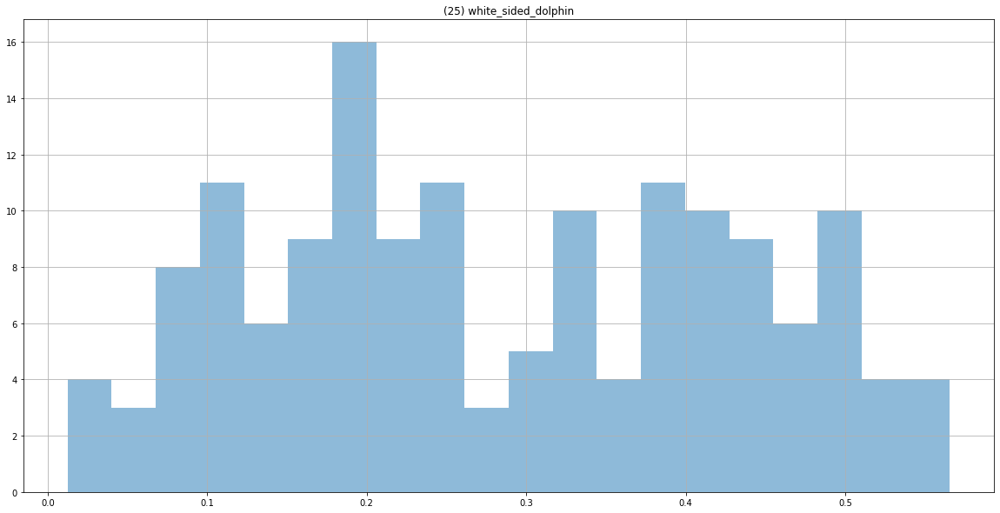

In [193]:
train_indices = np.where((predictions["folds"] != -1))[0]
test_indices = np.where((predictions["folds"] == -1))[0]

embeddings = predictions["embeddings"]
train_embeddings = embeddings[train_indices]
test_embeddings = embeddings[test_indices]

topk_distances, topk_predictions = topk(train_embeddings, test_embeddings, k=1)
plt.figure(figsize=(20, 10))
plt.hist(topk_distances.numpy()[:, 0], alpha=0.5, bins=20)

plt.grid()
plt.show()

for specie in range(26):
    train_indices = np.where((predictions["folds"] != -1) & (predictions["specie_labels"] == specie))[0]
    test_indices = np.where((predictions["folds"] == -1) & (predictions["specie_labels"] == specie))[0]

    embeddings = predictions["embeddings"]
    train_embeddings = embeddings[train_indices]
    test_embeddings = embeddings[test_indices]

    topk_distances, topk_predictions = topk(train_embeddings, test_embeddings, k=1)
    plt.figure(figsize=(20, 10))
    plt.hist(topk_distances.numpy()[:, 0], alpha=0.5, bins=20)

    plt.grid()
    plt.title(f"({specie}) {label2specie[specie]}")
    plt.show()

In [197]:
np.linalg.norm(embeddings.numpy(), axis=1)

(78989,)

In [207]:
few_shot_iids = df.individual_id.value_counts()[df.individual_id.value_counts() < 5].index
few_shot_indices = df[df.individual_id.isin(few_shot_iids)].index

In [237]:
import numpy as np

embeddings = predictions["embeddings"]

result = []
for specie in range(26):
    train_indices = np.where((predictions["folds"] != -1) & (predictions["specie_labels"] == specie))[0]
    result.append(np.linalg.norm(embeddings[train_indices], axis=1))
    
_df = []
for specie in range(26):
    for res in result[specie]:
        _df.append({
            "magnitude": res,
            "specie": label2specie[specie]
        })
        
_df = pd.DataFrame(_df)
px.line(_df, y="magnitude", color="specie")

In [247]:
(np.hstack(result) < 0.95).sum()

1476

In [235]:
import numpy as np

embeddings = predictions["embeddings"]

result = []
for specie in range(26):
    train_indices = np.where((predictions["folds"] != -1) & (predictions["specie_labels"] == specie))[0]
    result.append(np.linalg.norm(embeddings[train_indices], axis=1))
    
_df = []
for specie in range(26):
    for res in result[specie]:
        _df.append({
            "magnitude": res,
            "specie": label2specie[specie]
        })
        
_df = pd.DataFrame(_df)
px.line(_df, y="magnitude", color="specie")

In [227]:
import numpy as np

result = []
for specie in range(26):
    train_indices = np.where((predictions["folds"] != -1) & (predictions["specie_labels"] == specie))[0]
    result.append(np.linalg.norm(embeddings[train_indices], axis=1))
    
_df = []
for specie in range(26):
    for res in result[specie]:
        _df.append({
            "magnitude": res,
            "specie": label2specie[specie]
        })
        
_df = pd.DataFrame(_df)
px.line(_df, y="magnitude", color="specie")

In [229]:
import numpy as np

result = []
for specie in range(26):
    train_indices = np.where((predictions["folds"] != -1) & ((predictions["folds"] != 0)) & (predictions["specie_labels"] == specie))[0]
    result.append(np.linalg.norm(embeddings[train_indices], axis=1))
    
_df = []
for specie in range(26):
    for res in result[specie]:
        _df.append({
            "magnitude": res,
            "specie": label2specie[specie]
        })
        
_df = pd.DataFrame(_df)
px.line(_df, y="magnitude", color="specie")

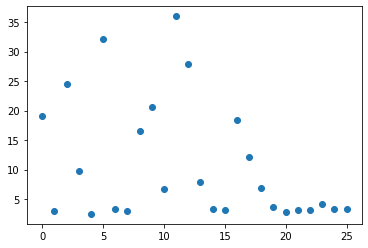

In [341]:
plt.scatter(np.arange(26), _df.groupby("specie")["magnitude"].std())

In [368]:
fold = 0
train_indices = np.where((predictions["folds"] != fold) & (predictions["folds"] != -1))[0]

imax = np.linalg.norm(embeddings[train_indices].numpy(), axis=1).argsort()

In [369]:
imax

array([31373,  4184, 17487, ..., 19745,  3027, 34946])

In [382]:
for i in range(1, 100):
    iidi = df.iloc[train_indices].iloc[imax[-i]].individual_id
    item_i = df[df.individual_id == iidi][["species", "individual_id", "box_yolov5_fish_v3", "box_yolov5_fin_v3"]]
    total = len(item_i)
    print(f"{item_i.species.values[0]}, {item_i.individual_id.values[0]}, {total}, {item_i.box_yolov5_fish_v3.isna().sum() / total:.3f}, {item_i.box_yolov5_fin_v3.isna().sum() / total:.3f}")

gray_whale, e60178a4c756, 32, 0.000, 0.875
beluga_whale, 12f2a4406d7e, 44, 0.000, 1.000
humpback_whale, 0b180ad0afa2, 38, 0.026, 0.026
humpback_whale, 0b180ad0afa2, 38, 0.026, 0.026
humpback_whale, 0b180ad0afa2, 38, 0.026, 0.026
humpback_whale, 0b180ad0afa2, 38, 0.026, 0.026
humpback_whale, 0b180ad0afa2, 38, 0.026, 0.026
beluga_whale, 12f2a4406d7e, 44, 0.000, 1.000
humpback_whale, 0b180ad0afa2, 38, 0.026, 0.026
humpback_whale, 0b180ad0afa2, 38, 0.026, 0.026
humpback_whale, 0b180ad0afa2, 38, 0.026, 0.026
bottlenose_dolphin, e69d5f9f8d1e, 126, 0.000, 0.000
beluga_whale, 12f2a4406d7e, 44, 0.000, 1.000
beluga_whale, 0a67aa3bfe4e, 39, 0.000, 0.974
bottlenose_dolphin, e69d5f9f8d1e, 126, 0.000, 0.000
beluga_whale, 255682316920, 24, 0.000, 0.875
humpback_whale, 0b180ad0afa2, 38, 0.026, 0.026
humpback_whale, 0b180ad0afa2, 38, 0.026, 0.026
humpback_whale, 0b180ad0afa2, 38, 0.026, 0.026
humpback_whale, 0b180ad0afa2, 38, 0.026, 0.026
humpback_whale, 0b180ad0afa2, 38, 0.026, 0.026
beluga_whale, 0a6

In [376]:
df[df.individual_id == "12f2a4406d7e"][["species", "box_yolov5_fish_v3", "box_yolov5_fin_v3"]]

,species,box_yolov5_fish_v3,box_yolov5_fin_v3
331,beluga_whale,82 2 1402 373,NaN
1464,beluga_whale,93 39 459 157,NaN
3808,beluga_whale,87 24 434 80,NaN
4773,beluga_whale,2 1 508 81,NaN
5169,beluga_whale,114 54 1725 499,NaN
5305,beluga_whale,0 0 3600 760,NaN
5822,beluga_whale,117 40 1097 228,NaN
6303,beluga_whale,65 32 1753 357,NaN
6419,beluga_whale,52 0 1044 215,NaN
6527,beluga_whale,169 80 549 185,NaN


In [355]:
for sp, group in df.groupby("species"):
    print(sp, group.individual_id.value_counts().max())

beluga_whale 77
blue_whale 9
bottlenose_dolphin 155
brydes_whale 17
commersons_dolphin 4
common_dolphin 74
cuviers_beaked_whale 10
dusky_dolphin 9
false_killer_whale 88
fin_whale 122
frasiers_dolphin 2
gray_whale 73
humpback_whale 135
killer_whale 45
long_finned_pilot_whale 5
melon_headed_whale 10
minke_whale 400
pantropic_spotted_dolphin 21
pygmy_killer_whale 14
rough_toothed_dolphin 4
sei_whale 10
short_finned_pilot_whale 8
southern_right_whale 8
spinner_dolphin 18
spotted_dolphin 11
white_sided_dolphin 5


In [335]:
for specie in range(26):
    scounts = df[df.species_label == specie].individual_id.value_counts()
    print(label2specie[specie], )

beluga_whale 322a18725969    77
51081e431bca    72
dba4e482f0ad    70
06ef73efe924    63
8deb2171580e    59
                ..
d279790e58b6     1
558bf6cf6ba9     1
57d273eec3c1     1
3e21193ffaaa     1
0f2d491d49f4     1
Name: individual_id, Length: 1012, dtype: int64
blue_whale a56b48593757    9
264cec6c4bfa    9
4587a8a3ff26    8
4f08077f3032    8
bb2a2b80309c    7
               ..
40af78d9ba54    1
6ea33c31b9fb    1
1cf49df8843e    1
6a735ede46e0    1
6e4ab8170cdf    1
Name: individual_id, Length: 2348, dtype: int64
bottlenose_dolphin a6e325d8e924    155
c995c043c353    153
f195c38bcf17    146
ffbb4e585ff2    145
281504409737    143
               ... 
540509c1bb1e      1
17033d1bc16a      1
1168aa4273eb      1
edda2dac25ac      1
f949a9ffa36b      1
Name: individual_id, Length: 904, dtype: int64
brydes_whale 83afdba5e8e5    17
c5e9ea6e720c    11
a1476df64cb3     9
a5fa185061f0     8
2ffa695a8244     8
f8816822486e     7
171aa23102f3     7
851a09c20be2     6
f941eb8400a2     5
0a7

In [306]:
train_indices = np.where((predictions["folds"] != -1) & ((predictions["folds"] != 0)))[0]
test_indices = np.where((predictions["folds"] != -1) & ((predictions["folds"] == 0)))[0]

submit = build_submit(train_indices, test_indices, new_threshold=0.4, val=True)
map5 = map_submit(test_indices, submit)
print(map5)
map1 = map_submit(test_indices, submit, k=1)
print(map1)

0.8246415858397832
0.7784853531889879


In [307]:
submit["error"] = 0
for i, row in enumerate(tqdm(submit.itertuples())):
    pred_iid = row.predictions.split()[:1]
    gt_iid = df[df.image == row.image].individual_id.values[0]
    if (row.new == 1) and ("new_individual" in pred_iid):
        continue
    if gt_iid not in pred_iid:
        submit.loc[i, "error"] = 1

0it [00:00, ?it/s]

In [319]:
import numpy as np

embeddings = predictions["embeddings"]

result, errors, _news, _iid_counts = [], [], [], []
for specie in range(26):
    train_indices = np.where((predictions["folds"] == 0) & (predictions["specie_labels"] == specie))[0]
    norms = np.linalg.norm(embeddings[train_indices], axis=1)
    result.append(norms)
    image_ids = predictions["image_ids"][train_indices]
    errors.append(submit[submit.image.isin(image_ids)].error.values)
    _news.append(submit[submit.image.isin(image_ids)].new.values)
    
    iid_cnts = df[df.image.isin(image_ids) & (df.fold == 0)].individual_id.value_counts().to_dict()
    im_cnts = []
    for imid in image_ids:
        iid = df[(df.image == imid)].individual_id.values[0]
        im_cnts.append(iid_cnts[iid])

    _iid_counts.append(im_cnts)
    
    
_df = []
for specie in range(26):
    for res, err, new, im_cnt in zip(result[specie], errors[specie], _news[specie], _iid_counts[specie]):
        _df.append({
            "magnitude": res,
            "specie": label2specie[specie],
            "error": err,
            "new": new,
            "count": im_cnt,
        })
        
_df = pd.DataFrame(_df)
px.line(_df, y="magnitude", color="error")

In [321]:
_df["few_shot"] = _df["count"] == 1
px.line(_df, y="magnitude", color="few_shot")

In [330]:
_df["few_shot"] = _df["count"] == 5
px.line(_df, y="magnitude", color="few_shot")

In [223]:
# from IPython.display import display, HTML
# display(HTML("<style>.container { width:100% !important; }</style>"))

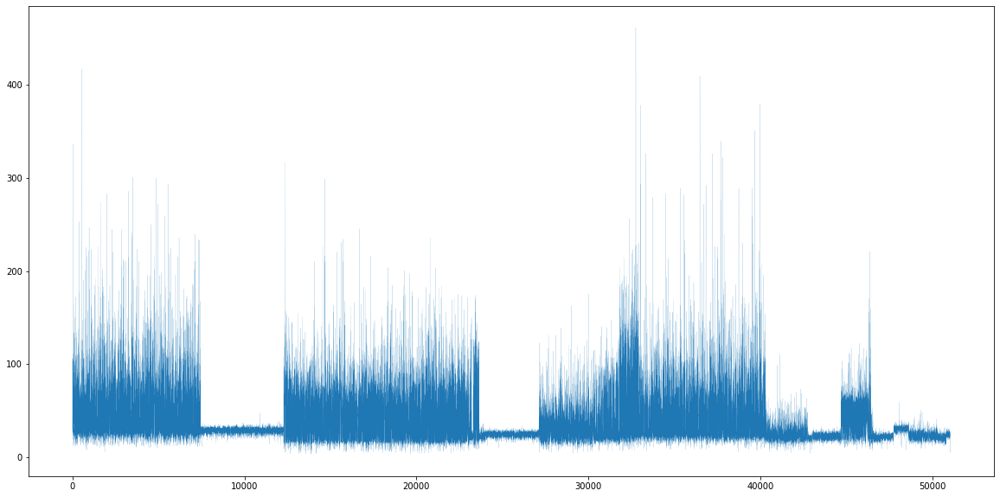

In [218]:
plt.figure(figsize=(20, 10))
plt.plot(np.hstack(result), linewidth=0.1)

<AxesSubplot:>

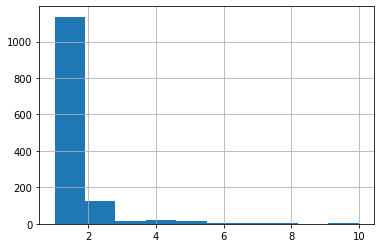

In [168]:
df[df.species == "melon_headed_whale"].individual_id.value_counts().hist()

In [144]:
topk_distances.mean(), 2 * topk_distances.std()

(tensor(0.4922), tensor(0.1546))

In [145]:
(topk_distances >= 0.4).sum() / topk_distances.shape[0]

tensor(0.9022)

In [155]:
train_indices = np.where((predictions["folds"] != fold) & (predictions["folds"] != -1))[0]
test_indices = np.where((predictions["folds"] == fold) & (predictions["news"] != 1))[0]

embeddings = predictions["embeddings"]
train_embeddings = embeddings[train_indices]
test_embeddings = embeddings[test_indices]

topk_distances, topk_predictions = topk(train_embeddings, test_embeddings, k=1)

In [156]:
false_new = np.where((topk_distances[:, 0] > 0.5) & (topk_distances[:, 0] < 0.6))[0]
df.iloc[test_indices[false_new]].species.value_counts()

beluga_whale                 156
blue_whale                   153
humpback_whale                83
southern_right_whale          49
gray_whale                    30
dusky_dolphin                 23
bottlenose_dolphin            16
spinner_dolphin               11
fin_whale                     11
killer_whale                   8
short_finned_pilot_whale       6
melon_headed_whale             5
false_killer_whale             4
minke_whale                    2
cuviers_beaked_whale           2
pantropic_spotted_dolphin      1
sei_whale                      1
common_dolphin                 1
white_sided_dolphin            1
Name: species, dtype: int64

In [153]:
np.where((predictions["folds"] == fold) & (predictions["specie_labels"] == 7))[0].shape

(645,)

<BarContainer object of 1517 artists>

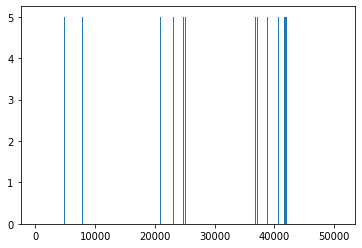

In [95]:
plt.bar(test_indices[false_new], height=5)

In [105]:
df.iloc[test_indices[false_new]].image.isin(hand_labels).sum()

242

In [108]:
label2specie = dict()

for row in df[["species", "species_label"]].itertuples():
    label2specie[row.species_label] = row.species

In [117]:
label2specie

{15: 'melon_headed_whale',
 12: 'humpback_whale',
 8: 'false_killer_whale',
 2: 'bottlenose_dolphin',
 0: 'beluga_whale',
 16: 'minke_whale',
 9: 'fin_whale',
 1: 'blue_whale',
 11: 'gray_whale',
 22: 'southern_right_whale',
 5: 'common_dolphin',
 13: 'killer_whale',
 21: 'short_finned_pilot_whale',
 7: 'dusky_dolphin',
 14: 'long_finned_pilot_whale',
 20: 'sei_whale',
 23: 'spinner_dolphin',
 6: 'cuviers_beaked_whale',
 24: 'spotted_dolphin',
 3: 'brydes_whale',
 4: 'commersons_dolphin',
 25: 'white_sided_dolphin',
 19: 'rough_toothed_dolphin',
 17: 'pantropic_spotted_dolphin',
 18: 'pygmy_killer_whale',
 10: 'frasiers_dolphin'}

In [115]:
for specie in range(26):
    train_indices = np.where((predictions["folds"] != fold) & (predictions["folds"] != -1) & 
                             (predictions["specie_labels"] == specie))[0]
    test_indices = np.where((predictions["folds"] == fold) & (predictions["specie_labels"] == specie))[0]
    submit = build_submit(train_indices, test_indices, new_threshold=0.4, val=True)
    map5 = map_submit(test_indices, submit)
    print(label2specie[specie], map5)

beluga_whale 0.7109434384082272
blue_whale 0.6035513361462728
bottlenose_dolphin 0.9635678782230506
brydes_whale 0.9090909090909091
commersons_dolphin 0.7592592592592592
common_dolphin 0.8457142857142858
cuviers_beaked_whale 0.8098958333333333
dusky_dolphin 0.931421188630491
false_killer_whale 0.9883084577114427
fin_whale 0.8396379525593008
frasiers_dolphin 1.0
gray_whale 0.709825327510917
humpback_whale 0.8769911504424779
killer_whale 0.9079725085910653
long_finned_pilot_whale 0.9615384615384616
melon_headed_whale 0.945050505050505
minke_whale 0.9475966562173459
pantropic_spotted_dolphin 0.85
pygmy_killer_whale 0.9313725490196079
rough_toothed_dolphin 0.9270833333333333
sei_whale 0.8999999999999999
short_finned_pilot_whale 0.9300894854586128
southern_right_whale 0.48502673796791446
spinner_dolphin 0.889970930232558
spotted_dolphin 0.915798611111111
white_sided_dolphin 0.8014184397163121


In [119]:
(specie_labels[predictions["folds"] == -1] == 22).sum()

662

In [112]:
predictions["embeddings"] = predictions["embeddings"][0, :, 0]

In [101]:
predictions["embeddings"] = torch.load(f"../predictions/{EXP}_embeddings.pt")

In [102]:
fold = 0

train_indices = np.where((predictions["folds"] != fold) & (predictions["folds"] != -1))[0]
test_indices = np.where(predictions["folds"] == fold)[0]

predictions["embeddings"] = F.normalize(predictions["embeddings"], dim=-1).mean(dim=1)
train_embeddings = F.normalize(predictions["embeddings"], dim=-1)[train_indices]
val_embeddings = F.normalize(predictions["embeddings"], dim=-1)[test_indices]

for dist_thresh in [0.1, 0.2, 0.3, 0.4, 0.5]:
    predictions["embeddings"][train_indices] = blend_embeddings(train_embeddings, dist_thresh)
    predictions["embeddings"][test_indices] = blend_embeddings(val_embeddings, dist_thresh)

    best_thresh, best_map, maps = choose_threshold(train_indices, test_indices, t_min=0.35, t_max=0.45)
    print(dist_thresh, best_thresh, best_map)

  0%|          | 0/40826 [00:00<?, ?it/s]

  0%|          | 0/10207 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

0.1 0.4 0.841788315208517


  0%|          | 0/40826 [00:00<?, ?it/s]

  0%|          | 0/10207 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

0.2 0.4 0.8400933999542797


  0%|          | 0/40826 [00:00<?, ?it/s]

  0%|          | 0/10207 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [98]:
fold = 0

train_indices = np.where((predictions["folds"] != fold) & (predictions["folds"] != -1))[0]
test_indices = np.where(predictions["folds"] == fold)[0]

predictions["embeddings"] = F.normalize(predictions["embeddings"], dim=-1).mean(dim=1)
train_embeddings = F.normalize(predictions["embeddings"], dim=-1)[train_indices]
val_embeddings = F.normalize(predictions["embeddings"], dim=-1)[test_indices]

for dist_thresh in [0.1, 0.2, 0.3, 0.4, 0.5]:
    predictions["embeddings"][train_indices] = blend_embeddings(train_embeddings, dist_thresh)

    best_thresh, best_map, maps = choose_threshold(train_indices, test_indices, t_min=0.35, t_max=0.45)
    print(dist_thresh, best_thresh, best_map)

  0%|          | 0/40826 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

0.1 0.4 0.8422634793115834


  0%|          | 0/40826 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

0.2 0.4 0.8420920283465596


  0%|          | 0/40826 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

0.3 0.4 0.8419565004408738


KeyboardInterrupt: 

In [80]:
fold = 0

embeddings = F.normalize(predictions["embeddings"], dim=-1).mean(dim=1)[predictions["folds"] != -1]

for dist_thresh in [0.1, 0.2, 0.3, 0.4, 0.5]:    
    predictions["embeddings"] = blend_embeddings(embeddings, dist_thresh)

    train_indices = np.where((predictions["folds"] != fold) & (predictions["folds"] != -1))[0]
    test_indices = np.where(predictions["folds"] == fold)[0]

    best_thresh, best_map, maps = choose_threshold(train_indices, test_indices, t_min=0.35, t_max=0.45)
    print(dist_thresh, best_thresh, best_map)

  0%|          | 0/51033 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

0.1 0.39 0.8417703536788478


  0%|          | 0/51033 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

0.2 0.4 0.8410812840860848


  0%|          | 0/51033 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

0.3 0.4 0.8391740962084845


  0%|          | 0/51033 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [12]:
fold = 0

all_embeddings = predictions["embeddings"]
predictions["embeddings"] = F.normalize(all_embeddings, dim=-1).mean(dim=1)

train_indices = np.where((predictions["folds"] != fold) & (predictions["folds"] != -1))[0]
test_indices = np.where(predictions["folds"] == fold)[0]

best_thresh, best_map, maps = choose_threshold(train_indices, test_indices, plot=True, t_min=0.35, t_max=0.45)
print(best_thresh, best_map)
predictions["embeddings"] = all_embeddings

  0%|          | 0/11 [00:00<?, ?it/s]

(0.38, 0.8427908951373241, [0.8399121517912544, 0.8409114659873944, 0.8415858397831553, 0.8427908951373241, 0.8425051435289508, 0.8420071192972144, 0.8420136507625486, 0.8403073054439764, 0.8385029881453903, 0.8361108389667221, 0.8327177427255804])


In [25]:
fold = 0

all_embeddings = predictions["embeddings"]
predictions["embeddings"] = F.normalize(all_embeddings, dim=-1).mean(dim=1)

train_indices = np.where((predictions["folds"] != fold) & (predictions["folds"] != -1))[0]
test_indices = np.where(predictions["folds"] == fold)[0]

best_thresh, best_map, maps = choose_threshold(train_indices, test_indices, plot=True, t_min=0.35, t_max=0.45, 
                                               average_by_individ=True)
print(best_thresh, best_map)
predictions["embeddings"] = all_embeddings

  0%|          | 0/11 [00:00<?, ?it/s]

0.41000000000000003 0.8426047483752981


## Blending params search

In [36]:
algos = [1, 2, 3]
result = [0]
result_weights, result_maps = [1.0], [0.0]

def get_prev(arr):
    prev = arr[result[0]]
    for i, wi in zip(result, result_weights):
        prev = (1 - wi) * prev + wi * arr[i]
    return prev

best_map = 
while len(algos) > 0:
    prev_embs = get_prev(embs)
    prev_kls = get_prev(kls)
    prev_sps = get_prev(sps)
    
    it_best_map, it_best_thresh, it_best_algo, it_best_alpha = 0, -1, -1, -1
    for algo in algos:
        algo_best_thresh, algo_best_map, algo_best_alpha = 0.0, 0.0, 0.0
        for alpha in np.arange(0.0, 1.0, 0.1):
            cur_embs = (1 - alpha) * prev_embs + alpha * embs[algo]
            cur_kls = (1 - alpha) * prev_kls + alpha * kls[algo]
            cur_sps = (1 - alpha) * prev_sps + alpha * sps[algo]
            best_thresholds, best_maps = choose_threshold_cv()
            alpha_best_map = np.mean(best_maps)
            if alpha_best_map > algo_best_map:
                algo_best_map = alpha_best_map
                algo_best_thresh = np.mean(best_thresholds)
                algo_best_alpha = alpha
                
        if algo_best_map > it_best_map:
            

tensor(True)

## Submit

In [37]:
EXP = "b7v5_b7v3_b6v5_b6v3_cat"
best_map = 0.864
best_thresh = 0.45

In [38]:
######################
#    Single model
######################

# predictions["embeddings"] = (embv5 + embv3) / 2
# predictions["embeddings"] = (embv5b7 + embv3b7 + embv5b6) / 3
# predictions["embeddings"] = (emb_v5b7 + emb_v31b7) / 2
all_embeddings = predictions["embeddings"]

# predictions["embeddings"] = all_embeddings[:, 1]  # 0 fin, 1 fish
# predictions["embeddings"] = F.normalize(all_embeddings, dim=2).mean(dim=1)
# predictions["embeddings"] = F.normalize(all_embeddings, dim=3).mean(dim=(0, 2))
predictions["embeddings"] = F.normalize(x, dim=1)

train_indices = np.where(predictions["folds"] != -1)[0]
test_indices = np.where(predictions["folds"] == -1)[0]
submit = build_submit(train_indices, test_indices, new_threshold=best_thresh)
submit.to_csv(
#     f"../submissions/{EXP}_f0_{round(best_map * 1000)}_th{best_thresh:.2f}_no_dup_both_hflip.csv", 
    f"../submissions/{EXP}_f01234cat_{round(best_map * 1000)}_th{best_thresh:.2f}_no_dup_both_hflip.csv",
    index=False
)

predictions["embeddings"] = all_embeddings

In [39]:
submit

,image,predictions
0,e0ab6b7bee83e4.jpg,78a3c99a3fb3 new_individual 46e4786e24c5 aa126...
1,95663015fcae47.jpg,new_individual 16d546640ec8 15d4eea40bd1 48067...
2,f15a75ca12835c.jpg,e6531f63e03e new_individual 6b3232ac3de9 21dbc...
3,cc16bcde109929.jpg,a265c977dc30 new_individual 5137800a3ef7 8351b...
4,fa0a44b78095a3.jpg,new_individual 3db418812f4f 247e4c6de07e d1554...
...,...,...
27951,8a87b27a5b3e1d.jpg,184ca553804f new_individual d95af1509132 d9bf6...
27952,caf61df5fd861b.jpg,7845337998d6 new_individual 4f7d1d8b4f9b 84502...
27953,f975a5e77bd4a6.jpg,9a6b86f7bb3e new_individual b53f62ae089a 0946d...
27954,d64421f49b919e.jpg,4ddb2eeb5efb new_individual d03806a6d0cc 0e466...


In [16]:
# #####################
# #      Ensemble
# #####################
# all_embeddings = predictions["embeddings"]
# predictions["embeddings"] = F.normalize(all_embeddings, dim=2).mean(axis=0)

# best_thresh = 0.43
# best_map = 0.78
# EXP = "tf_effb7_ns_m0.4_yolov5_fin_fish_v1_h20s50v30_b0.2c0.2_2ldp0.4_512x512_4g20x3b40e0.001lr"

# train_indices = np.where(predictions["folds"] != -1)[0]
# test_indices = np.where(predictions["folds"] == -1)[0]
# submit = build_submit(train_indices, test_indices, new_threshold=best_thresh)
# submit.to_csv(
#     f"../submissions/{EXP}_f01234_{round(best_map * 1000)}_th{best_thresh:.2f}_no_dup_klass_specie_avg_ind.csv", 
#     index=False
# )

# predictions["embeddings"] = all_embeddings

## Errors analysis

In [140]:
n_train = 51033

klass_probs = torch.load(
    "../predictions/tf_effb7_ns_m0.4_yolov5_9c_v3_augv3_2ldp0.4_512x512_4g20x3b60e0.001lr_klass_probs.pt")

specie_probs = torch.load(
    "../predictions/tf_effb7_ns_m0.4_yolov5_9c_v3_augv3_2ldp0.4_512x512_4g20x3b60e0.001lr_specie_probs.pt")

train_klass_oof = np.zeros(n_train)
train_specie_oof = np.zeros((n_train, 26))
for fold in range(5):
    fold_val_indices = np.where(predictions["folds"] == fold)[0]
    train_klass_oof[fold_val_indices] = klass_probs[fold, fold_val_indices].mean(axis=1)
    train_specie_oof[fold_val_indices] = specie_probs[fold, fold_val_indices].mean(axis=1)
    
train_klass_confidences = train_klass_oof.copy()
train_klass_oof = (train_klass_oof > 0.5).astype(int)
train_klass_confidences[train_klass_oof == 0] = 1 - train_klass_confidences[train_klass_oof == 0]

train_klass_labels = predictions["klass_labels"][:n_train]
klass_errors = np.where(train_klass_oof != train_klass_labels)[0]
klass_low_conf = np.where((0.5 <= train_klass_confidences) & (train_klass_confidences < 0.95))[0]
print(f"Klass:")
print(f"\tErrors: {len(klass_errors)}")
print(f"\tLow conf: {len(klass_low_conf)}")

train_specie_confidences = train_specie_oof.copy()
train_specie_oof = np.argmax(train_specie_oof, axis=1)
train_specie_confidences = train_specie_confidences[np.arange(len(train_specie_confidences)), train_specie_oof]

train_specie_labels = predictions["specie_labels"][:n_train]
specie_errors = np.where(train_specie_oof != train_specie_labels)[0]
specie_low_conf = np.where(train_specie_confidences < 0.7)[0]
print(f"Specie:")
print(f"\tErrors: {len(specie_errors)}")
print(f"\tLow conf: {len(specie_low_conf)}")

Klass:
	Errors: 79
	Low conf: 270
Specie:
	Errors: 287
	Low conf: 320


In [137]:
from matplotlib import pyplot as plt


CLASSES = ["dolphin", "whale"]


def visualize(indices):
    for i in indices:
        fname = predictions["image_ids"][i]
        name, ext = osp.splitext(fname)
        full_file = osp.join(TRAIN_IMAGES_DIR, fname)
        fish_file = osp.join(TRAIN_IMAGES_DIR, name + "_fish" + ext)
        fin_file = osp.join(TRAIN_IMAGES_DIR, name + "_fin" + ext)
        if not osp.exists(fish_file):
            fish_file = full_file
        if not osp.exists(fin_file):
            fin_file = fish_file

        full_image = cv2.imread(full_file)
        full_image = cv2.cvtColor(full_image, cv2.COLOR_BGR2RGB)

        fish_image = cv2.imread(fish_file)
        fish_image = cv2.cvtColor(fish_image, cv2.COLOR_BGR2RGB)

        fin_image = cv2.imread(fin_file)
        fin_image = cv2.cvtColor(fin_image, cv2.COLOR_BGR2RGB)

        image = np.hstack((fin_image, fish_image, full_image))

        pcls = CLASSES[train_klass_oof[i]]
        tcls = CLASSES[train_klass_labels[i]]

        plt.figure(figsize=(15, 5))
        plt.imshow(image)
        plt.title(f"p {pcls},  t {tcls},     {i}")
        plt.show()

In [139]:
# visualize(klass_low_conf)

In [96]:
import os
import os.path as osp
import numpy as np
import pandas as pd

train = pd.read_csv("../data/train.csv")
test = pd.read_csv("../data/sample_submission.csv")

yolov5_files = np.array([fname for fname in os.listdir("../yolov5/images/") if fname.endswith((".jpg", ".jpeg"))])
species = {row.image: row.species for row in train.itertuples()}
species = [species.get(fname, "test") for fname in yolov5_files]

In [97]:
from collections import Counter

sorted(Counter(species).items(), key=lambda x: x[1])

[('frasiers_dolphin', 14),
 ('rough_toothed_dolphin', 60),
 ('pygmy_killer_whale', 76),
 ('commersons_dolphin', 90),
 ('pantropic_spotted_dolphin', 145),
 ('brydes_whale', 154),
 ('white_sided_dolphin', 200),
 ('sei_whale', 200),
 ('long_finned_pilot_whale', 200),
 ('cuviers_beaked_whale', 201),
 ('spotted_dolphin', 201),
 ('common_dolphin', 202),
 ('short_finned_pilot_whale', 202),
 ('southern_right_whale', 206),
 ('melon_headed_whale', 206),
 ('fin_whale', 208),
 ('spinner_dolphin', 211),
 ('gray_whale', 226),
 ('minke_whale', 231),
 ('killer_whale', 256),
 ('test', 339),
 ('dusky_dolphin', 365),
 ('false_killer_whale', 455),
 ('beluga_whale', 625),
 ('blue_whale', 630),
 ('humpback_whale', 1060),
 ('bottlenose_dolphin', 1414)]

In [101]:
hand_labels = set(yolov5_files)

In [3]:
MIN_LABELED = 200

to_label = []
for sp, cnt in Counter(species).items():
    if cnt >= MIN_LABELED:
        continue
        
    not_labeled = []
    for row in train[train.species == sp].itertuples():
        if row.image not in yolov5_files:
            not_labeled.append(row.image)
            
    need_to_label = min(MIN_LABELED - cnt, len(not_labeled))
    if need_to_label > 0:
        to_label.extend(np.random.choice(not_labeled, size=need_to_label, replace=False))
        
len(to_label)

0

In [4]:
from sklearn.model_selection import train_test_split


train_fnames, val_fnames = train_test_split(
    yolov5_files, test_size=0.2, random_state=42, stratify=species, shuffle=True)

train_files = [f"images/{fname}" for fname in train_fnames]
val_files = [f"images/{fname}" for fname in val_fnames]

with open("../yolov5/kaggle_whales_yolo/train.txt", "w+") as outf:
    outf.write("\n".join(train_files))
    
with open("../yolov5/kaggle_whales_yolo/val.txt", "w+") as outf:
    outf.write("\n".join(val_files))
    

In [5]:
len(val_files), len(train_files)

(1676, 6701)

In [6]:
len(yolov5_files)

8377

In [97]:
from sklearn.model_selection import train_test_split

train_fnames, val_fnames = train_test_split(
    yolov5_files, test_size=0.2, random_state=42, stratify=species, shuffle=True)

1374

In [15]:
label_files = []
with open("../yolov5/kaggle_whales_yolo/train.txt") as inpf:
    label_files.extend(map(lambda x: x.strip()[7:], inpf.readlines()))
with open("../yolov5/kaggle_whales_yolo/val.txt") as inpf:
    label_files.extend(map(lambda x: x.strip()[7:], inpf.readlines()))

In [37]:
from tqdm import tqdm

count = 0
for fname in tqdm(label_files):
    name, ext = osp.splitext(fname)
    label_file = f"../yolov5/images/{name}.txt"
    if not osp.exists(label_file):
        continue
    
    labels = []
    with open(label_file) as inpf:
        lines = list(map(lambda x: x.strip(), inpf.readlines()))
        
    fin_boxes, fish_boxes = [], []
    for line in lines:
        clid, *bbox = line.split()
        clid = int(clid)
        bbox = list(map(float, bbox))
        if clid == 0:
            fin_boxes.append(bbox)
        elif clid == 1:
            fish_boxes.append(bbox)
        else:
            raise ValueError(f"Unexpected clid: {clid}")
            
    if len(fin_boxes) != 1 or len(fish_boxes) != 1:
        continue
        
    fin_boxes, fish_boxes = np.asarray(fin_boxes), np.asarray(fish_boxes)
    fin_boxes[:, [0, 1]] -= fin_boxes[:, [2, 3]] / 2
    fin_boxes *= 1280
    
    fish_boxes[:, [0, 1]] -= fish_boxes[:, [2, 3]] / 2
    fish_boxes *= 1280

    iou = calc_iou(fin_boxes, fish_boxes)[0, 0]
    if iou > 0.8:
        count += 1

100%|██████████| 8377/8377 [00:01<00:00, 5543.55it/s]
